<a href="https://colab.research.google.com/github/trung-source/License-plate-recognition/blob/master/Trung_Roboflow_Train_YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to Train YOLOv5 on Custom Objects

This tutorial is based on the [YOLOv5 repository](https://github.com/ultralytics/yolov5) by [Ultralytics](https://www.ultralytics.com/). This notebook shows training on **your own custom objects**. Many thanks to Ultralytics for putting this repository together - we hope that in combination with clean data management tools at Roboflow, this technologoy will become easily accessible to any developer wishing to use computer vision in their projects.

### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train YOLOv5](https://blog.roboflow.ai/how-to-train-yolov5-on-a-custom-dataset/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train YOLOv5 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install YOLOv5 dependencies
* Download custom YOLOv5 object detection data
* Write our YOLOv5 Training configuration
* Run YOLOv5 training
* Evaluate YOLOv5 performance
* Visualize YOLOv5 training data
* Run YOLOv5 inference on test images
* Export saved YOLOv5 weights for future inference



### **About**

[Roboflow](https://roboflow.com) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

**Looking for a vision model available via API without hassle? Try Roboflow Train.**

![Roboflow Wordmark](https://i.imgur.com/dcLNMhV.png)



#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [1]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo

%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 10555, done.
remote: Total 10555 (delta 0), reused 0 (delta 0), pack-reused 10555
Receiving objects: 100% (10555/10555), 10.73 MiB | 29.63 MiB/s, done.
Resolving deltas: 100% (7291/7291), done.
/content/yolov5
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [ ]:

%rm -r /content/yolov5/runs/train/yolov5s_results
%rm -r /content/yolov5/runs/train/yolov5s_results2

rm: cannot remove '/content/yolov5/runs/train/yolov5s_results': No such file or directory
rm: cannot remove '/content/yolov5/runs/train/yolov5s_results2': No such file or directory


In [2]:
# install dependencies as necessary
!pip3 install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 596 kB 7.2 MB/s 
Setup complete. Using torch 1.10.0+cu111 CPU


# Download Correctly Formatted Custom Dataset 

We'll download our dataset from Roboflow. Use the "**YOLOv5 PyTorch**" export format. Note that the Ultralytics implementation calls for a YAML file defining where your training and test data is. The Roboflow export also writes this format for us.

To get your data into Roboflow, follow the [Getting Started Guide](https://blog.roboflow.ai/getting-started-with-roboflow/).



![YOLOv5 PyTorch export](https://i.imgur.com/5vr9G2u.png)


In [3]:
#follow the link below to get your download code from from Roboflow
!pip3 install -q roboflow
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="roboflow-yolov5")

     |████████████████████████████████| 145 kB 8.2 MB/s 
     |████████████████████████████████| 178 kB 56.7 MB/s 
     |████████████████████████████████| 1.1 MB 55.1 MB/s 
     |████████████████████████████████| 67 kB 6.1 MB/s 
     |████████████████████████████████| 138 kB 54.6 MB/s 
     |████████████████████████████████| 63 kB 1.8 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=roboflow-yolov5


In [4]:
%cd /content/yolov5
#after following the link above, recieve python code with these fields filled in
from roboflow import Roboflow
rf = Roboflow(api_key="Ep0riydLFq34vFQ03JcK")
project = rf.workspace().project("licence-plate-3")
dataset = project.version(1).download("yolov5")

/content/yolov5
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Licence-Plate-3-1 in yolov5pytorch:: 100%|██████████| 2648/2648 [00:02<00:00, 1195.29it/s]


In [5]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat {dataset.location}/data.yaml

names:
- biensoxe
nc: 1
train: Licence-Plate-3-1/train/images
val: Licence-Plate-3-1/valid/images


# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [6]:
# define number of classes based on YAML
import yaml
with open(dataset.location + "/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [7]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [8]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [9]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [10]:
!git pull



Updating 886f1c0..436ffc4
Fast-forward
 .dockerignore                                      |  12 +-
 .github/FUNDING.yml                                |   5 +
 .github/ISSUE_TEMPLATE/bug-report.md               |  55 --
 .github/ISSUE_TEMPLATE/bug-report.yml              |  85 ++
 .github/ISSUE_TEMPLATE/config.yml                  |   8 +
 .github/ISSUE_TEMPLATE/feature-request.md          |  27 -
 .github/ISSUE_TEMPLATE/feature-request.yml         |  50 ++
 .github/ISSUE_TEMPLATE/question.md                 |  13 -
 .github/ISSUE_TEMPLATE/question.yml                |  33 +
 .github/dependabot.yml                             |  31 +-
 .github/workflows/ci-testing.yml                   |  48 +-
 .github/workflows/codeql-analysis.yml              |  66 +-
 .github/workflows/greetings.yml                    |  33 +-
 .github/workflows/rebase.yml                       |  10 +-
 .github/workflows/stale.yml                        |  26 +-
 .gitignore                                        

In [ ]:
!pip3 install wandb
# !tensorboard --logdir runs/train

     |████████████████████████████████| 1.7 MB 4.3 MB/s 
     |████████████████████████████████| 140 kB 48.2 MB/s 
     |████████████████████████████████| 97 kB 6.6 MB/s 
     |████████████████████████████████| 180 kB 43.8 MB/s 
     |████████████████████████████████| 63 kB 1.9 MB/s 
  Created wheel for subprocess32: filename=subprocess32-3.5.4-py3-none-any.whl size=6502 sha256=4c2c25f948fa30dcbb5c29bc3b24158fd39b794782fbc4335fc2ad0c47093441
  Stored in directory: /root/.cache/pip/wheels/50/ca/fa/8fca8d246e64f19488d07567547ddec8eb084e8c0d7a59226a
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8807 sha256=801f03745246dbbf056f9462149bea8d2d09a4b87affd2a25e0aa28b57a276a4
  Stored in directory: /root/.cache/pip/wheels/3e/31/09/fa59cef12cdcfecc627b3d24273699f390e71828921b2cbba2
Successfully built subprocess32 pathtools


In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python3 train.py --img 416 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 2
wandb: You chose 'Use an existing W&B account'
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
train: weights=, cfg=./models/custom_yolov5s.yaml, data=/content/yolov5/Licence-Plate-3-1/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_ran

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

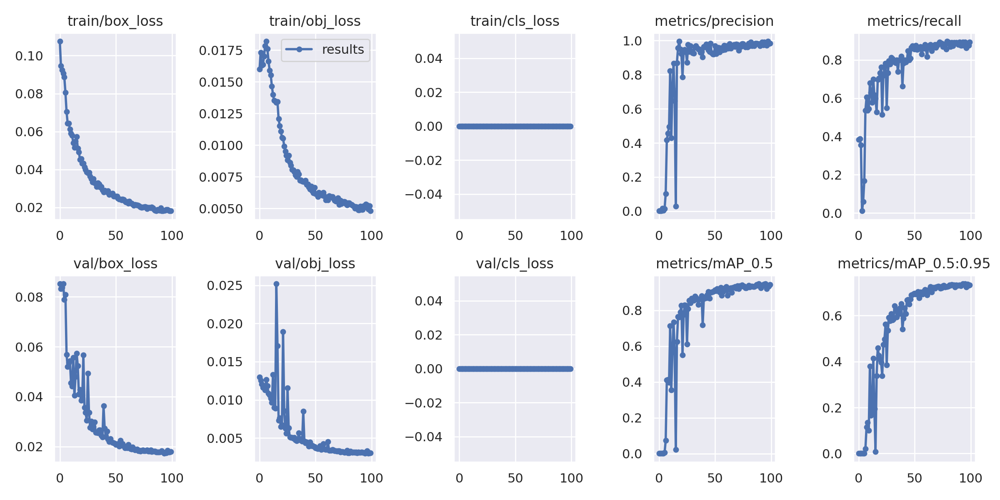

In [ ]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png

Image(filename='/content/yolov5/runs/train/yolov5s_results/results.png', width=1000)  # view results.png

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

GROUND TRUTH TRAINING DATA:


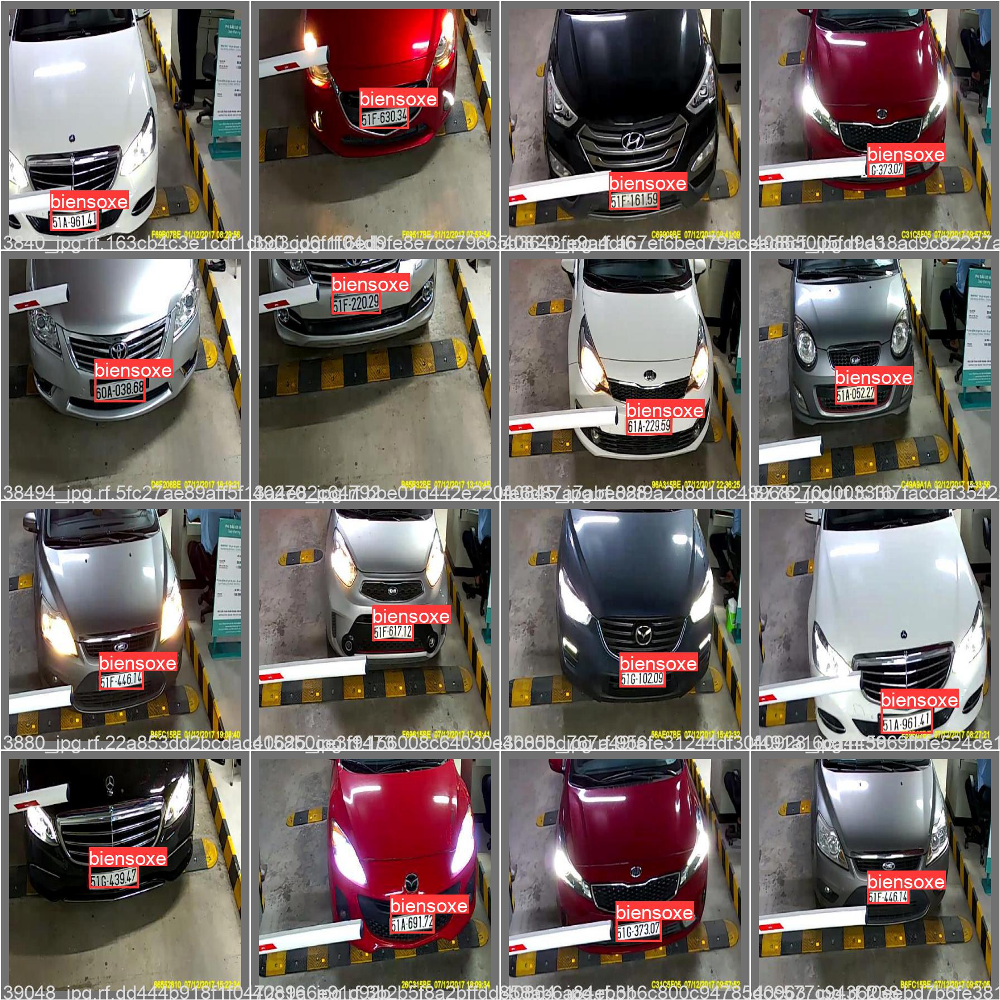

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/val_batch1_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


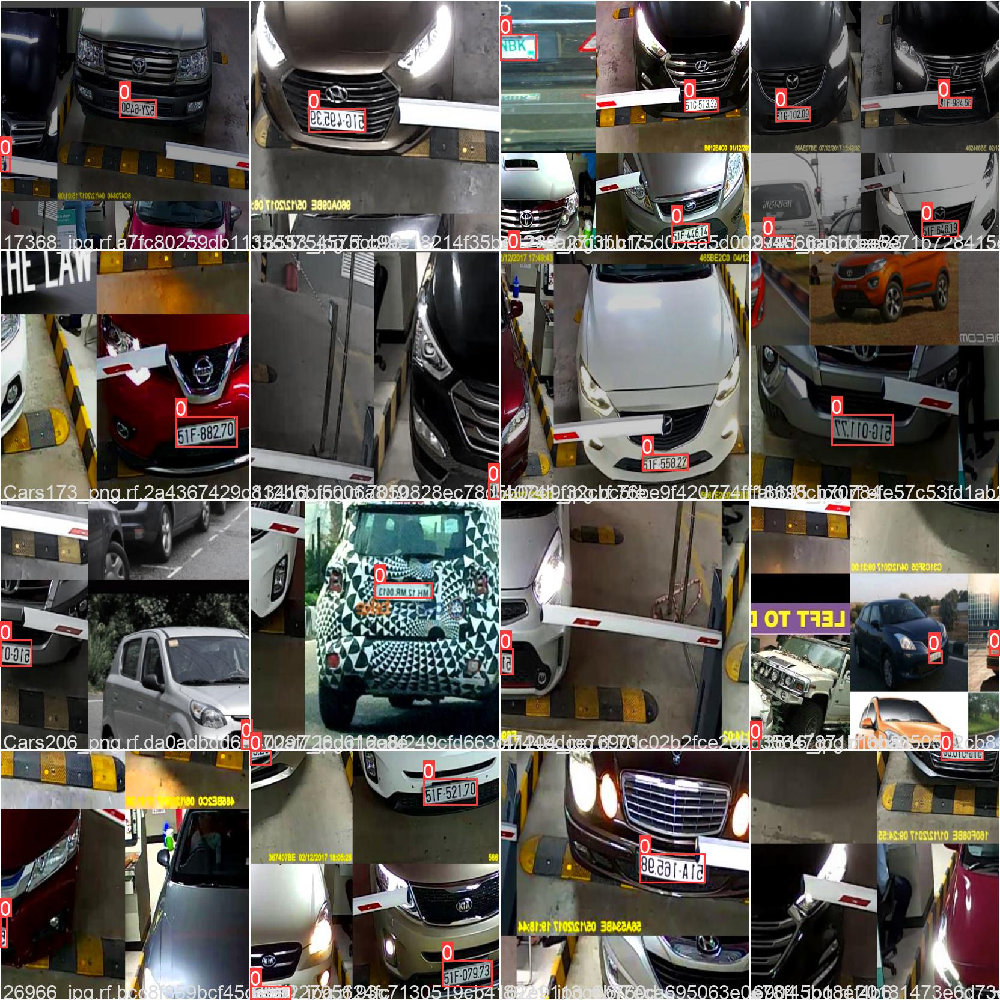

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch1.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [ ]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source /content/yolov5/Licence-Plate-3-1/test/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=/content/yolov5/Licence-Plate-3-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-172-gfb83929 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients, 16.8 GFLOPs
image 1/135 /content/yolov5/Licence-Plate-3-1/test/images/10690_jpg.rf.7773105a39a0ea0d2cef7a04ea93cc35.jpg: 416x416 1 biensoxe, Done. (0.031s)
image 2/135 /content/yolov5/Licence-Plate-3-1/test/images/10691_jpg.rf.778dc4d4fac9ef602a017bb03d656893.jpg: 416x416 1 biensoxe, Done. (0.031s)
image 3/135 /content/yolov5/Lice

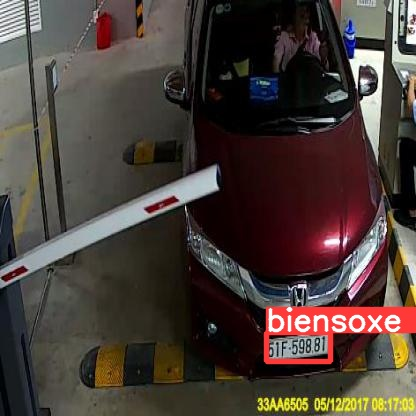

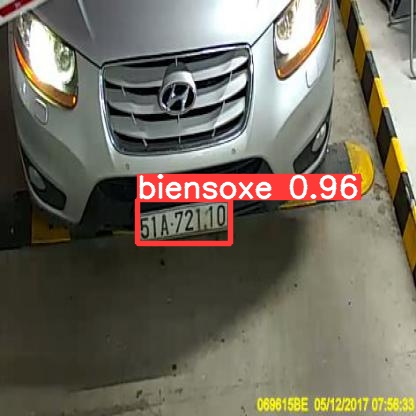

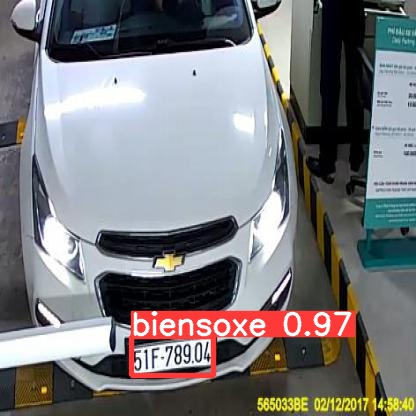

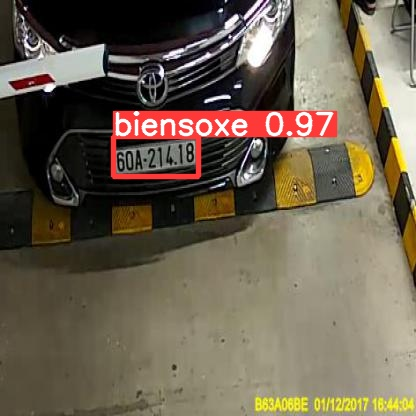

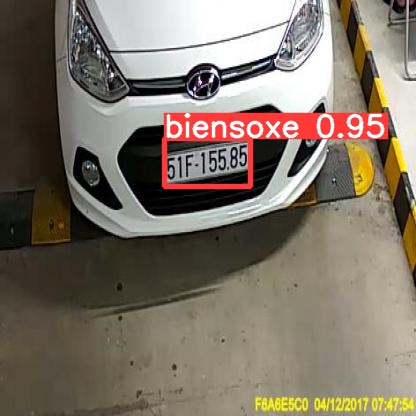

...

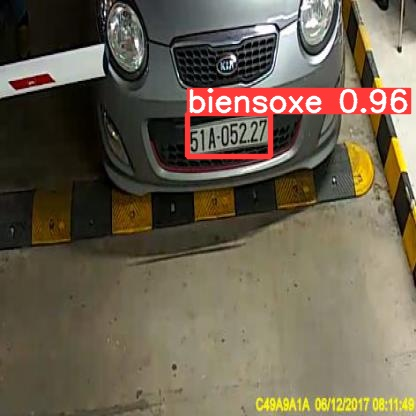

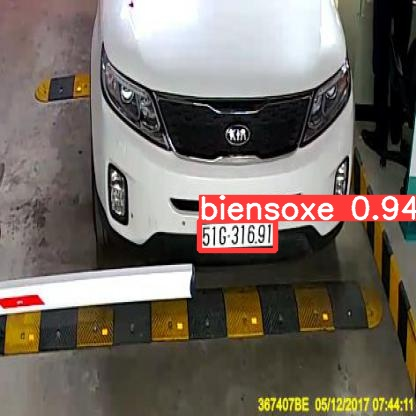

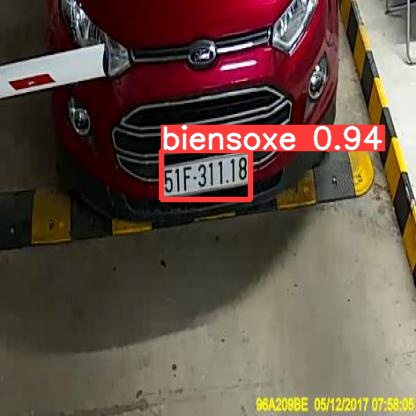

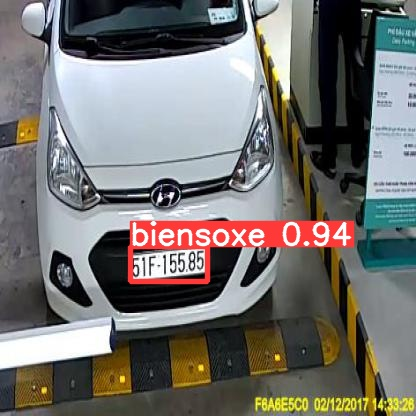

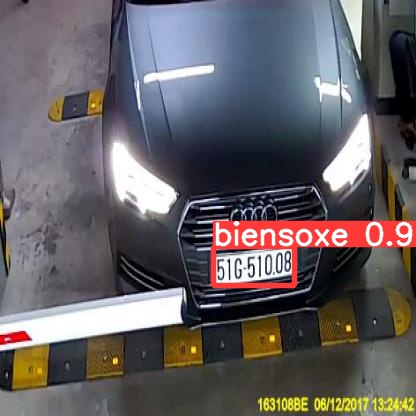

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [58]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [59]:
%cp /content/yolov5/runs/train/yolov5s_results/weights/best.pt /content/gdrive/My\ Drive

## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)

#Inference


In [ ]:
%cp /content/best.pt /content/yolov5

In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights best.pt --img 416 --conf 0.4 --source /content/yolov5/Licence-Plate-3-1/test/images

/content/yolov5
detect: weights=['best.pt'], source=/content/yolov5/Licence-Plate-3-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-188-g80473a6 torch 1.10.0+cu111 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients, 16.8 GFLOPs
image 1/135 /content/yolov5/Licence-Plate-3-1/test/images/10690_jpg.rf.7773105a39a0ea0d2cef7a04ea93cc35.jpg: 416x416 1 biensoxe, Done. (0.051s)
image 2/135 /content/yolov5/Licence-Plate-3-1/test/images/10691_jpg.rf.778dc4d4fac9ef602a017bb03d656893.jpg: 416x416 1 biensoxe, Done. (0.057s)
image 3/135 /content/yolov5/Licence-Plate-3-1/test/images/11477_jpg

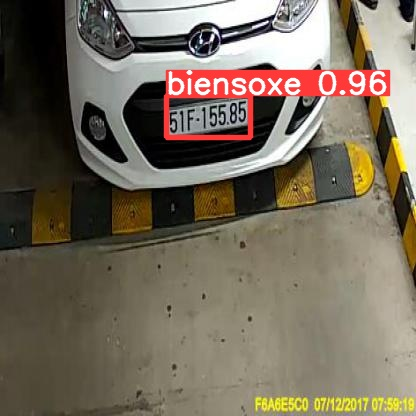

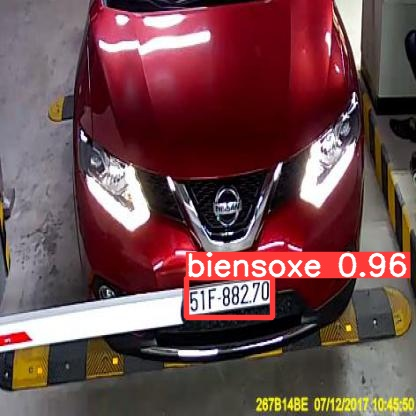

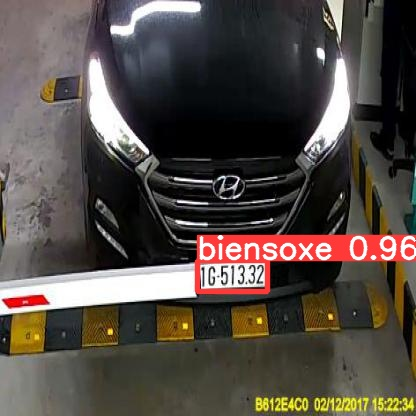

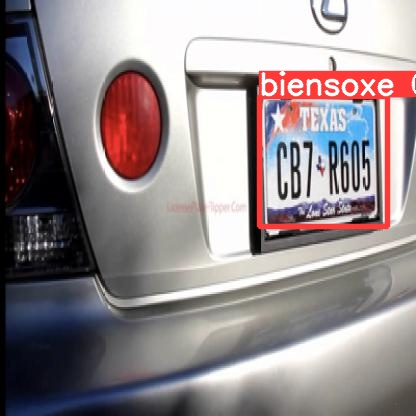

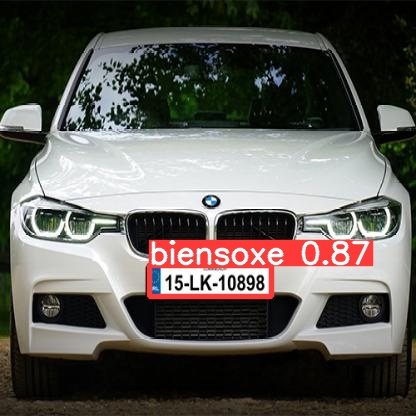

...

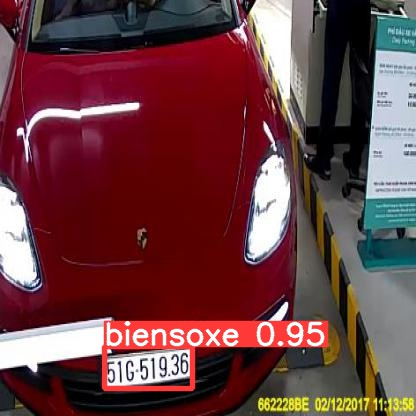

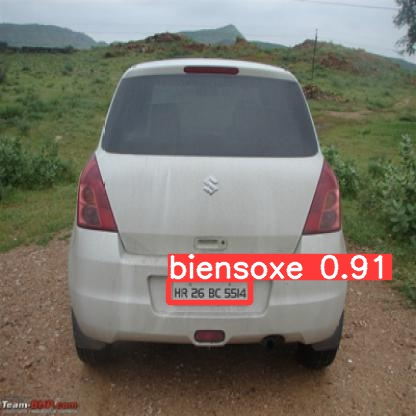

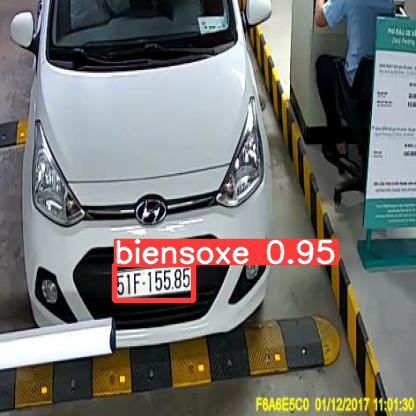

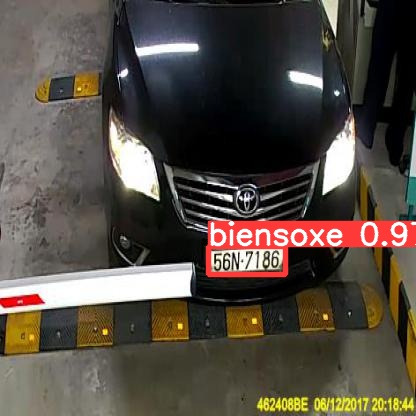

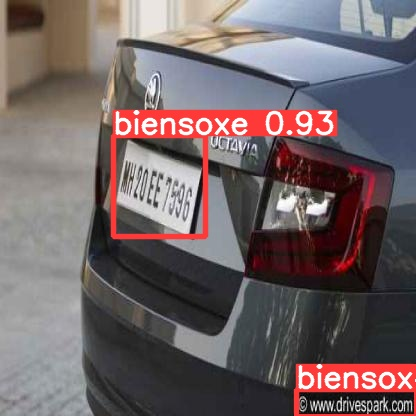

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")



```
# This is formatted as code
```

# CUSTOM_DETECT



In [11]:
!sudo apt install tesseract-ocr
!pip3 install pytesseract

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 37 not upgraded.
Need to get 4,795 kB of archives.
After this operation, 15.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Fetched 4,795 kB in 2s (3,025 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl

In [12]:
!pip3 uninstall opencv-python-headless
!pip3 install opencv-python-headless==4.1.2.30

     |████████████████████████████████| 21.8 MB 1.3 MB/s 


In [56]:
# !python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images
# !python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images/17618_jpg.rf.06237d32e466955dca5d64d285299ffa.jpg
# !python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images/4014_jpg.rf.434a8bdc6e57c28a1034c3dad3584609.jpg
# !python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images/Cars130_png.rf.e3f4899375445d619b6c936a42c0b438.jpg
# !python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images/9023_jpg.rf.49ed9b85ba55e6b038749305f108156a.jpg
# !python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images/Cars130_png.rf.e3f4899375445d619b6c936a42c0b438.jpg
# !python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images/40469_jpg.rf.e4aa04b94be15acfbb56cc0b7f80fe13.jpg
!python detect_custom.py --weights /content/best.pt --img 416 --conf 0.40 --source /content/test_2.mp4


# display(Image(filename='/content/yolov5/runs/detect/exp/*.jpg'))
# %rm -r runs/detect/exp*

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=416, iou_thres=0.35, line_thickness=2, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/content/test_2.mp4', update=False, view_img=False, weights=['/content/best.pt'])
YOLOv5 🚀 v6.0-192-g436ffc4 torch 1.10.0+cu111 CPU

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients, 16.8 GFLOPs
True
(894-07275

256x416 1 biensoxe, Done. (0.131s)
True
(BOA-072.751

256x416 1 biensoxe, Done. (0.116s)
True
(89A-072.75.

256x416 1 biensoxe, Done. (0.123s)
True
(B9A-072.75

256x416 1 biensoxe, Done. (0.118s)
True
(@9A-07275°

256x416 1 biensoxe, Done. (0.123s)
True
|'89A-07275

256x416 1 biensoxe, Done. (0.123s)
True
(894-072.75

256x416 1 biensoxe, Done. (0.120s)
True
1894-07275

256x416 1 biensoxe, Done. (0.117s)
True
89A-072.79

256x416 1 biensoxe, Done. (0.115s)

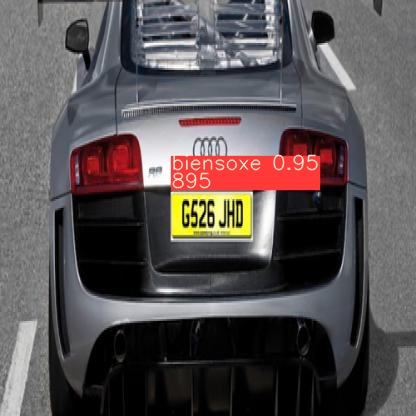

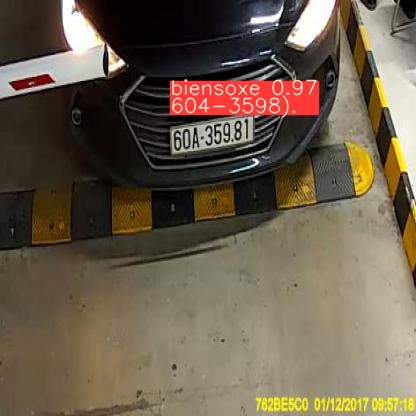

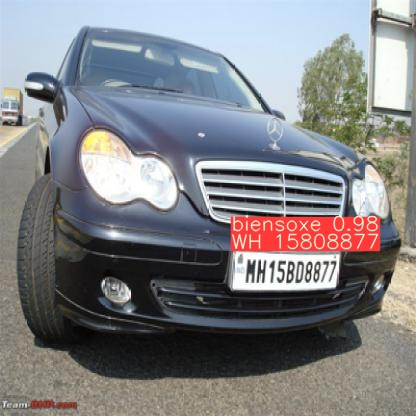

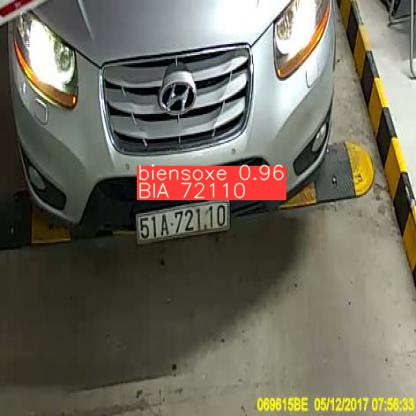

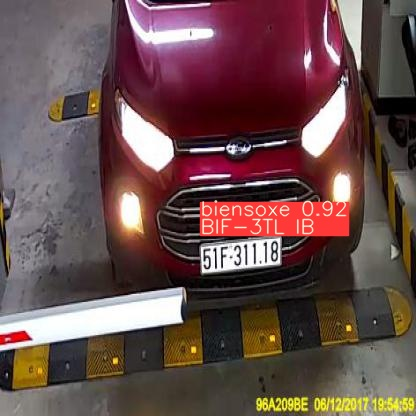

...

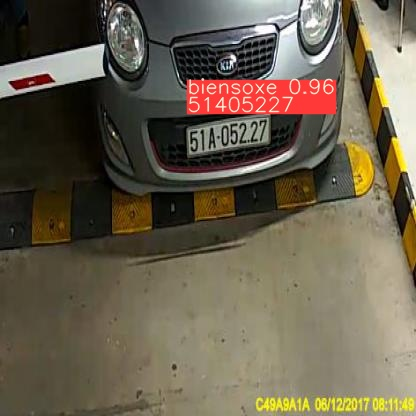

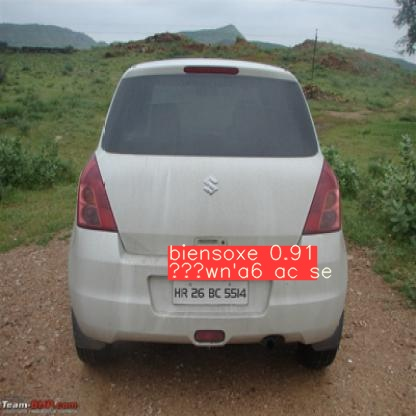

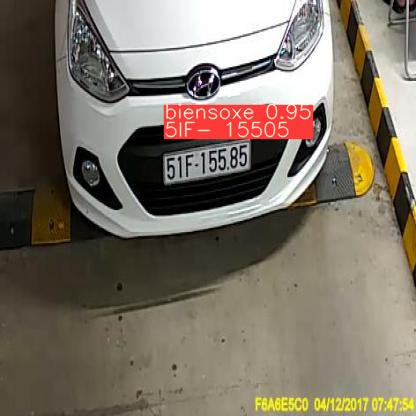

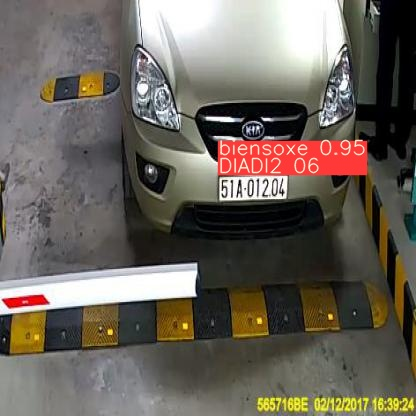

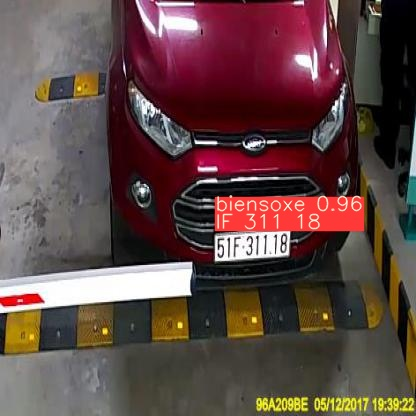

In [52]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")



In [57]:
%rm -r runs/detect/exp*

## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)



```
# This is formatted as code
```

# Pyterrasact



In [ ]:
!pip3 install easyocr
!pip3 install imutils
!pip3 install cv

In [ ]:
%cd ..

/content


In [ ]:
!sudo apt install tesseract-ocr
!pip3 install pytesseract

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 37 not upgraded.
Need to get 4,795 kB of archives.
After this operation, 15.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Fetched 4,795 kB in 1s (4,496 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl

In [ ]:
!pip3 show requests

Name: requests
Version: 2.27.1
Summary: Python HTTP for Humans.
Home-page: https://requests.readthedocs.io
Author: Kenneth Reitz
Author-email: me@kennethreitz.org
License: Apache 2.0
Location: /usr/local/lib/python3.7/dist-packages
Requires: certifi, urllib3, idna, charset-normalizer
Required-by: tweepy, torchtext, tensorflow-datasets, tensorboard, Sphinx, spacy, roboflow, requests-oauthlib, pymystem3, pooch, panel, pandas-datareader, kaggle, gspread, google-colab, google-api-core, gdown, folium, fix-yahoo-finance, fastai, coveralls, community, CacheControl


In [ ]:
!python detect_custom.py --weights /content/best.pt --img 720 --conf 0.40 --source /content/yolov5/Licence-Plate-3-1/test/images

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, hide_conf=False, hide_labels=False, img_size=720, iou_thres=0.35, line_thickness=2, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/content/yolov5/Licence-Plate-3-1/test/images', update=False, view_img=False, weights=['/content/best.pt'])
YOLOv5 🚀 v6.0-191-ga1a9c68 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients, 16.8 GFLOPs
51 A-654.74

736x736 1 biensoxe, Done. (0.012s)
51A-654.74

736x736 1 biensoxe, Done. (0.013s)
516-495. 39

736x736 1 biensoxe, Done. (0.016s)
View


736x736 2 biensoxes, Done. (0.013s)

5 16-499.39

736x736 2 biensoxes, Done. (0.013s)
BIF-734.20

736x736 1 biensoxe, Done. (0.013s)
516-216.70

736x736 1 biensoxe, Done. (0.013s)
b1F-098.8!

736x736 1 biensoxe, Done. (0.014s)
BIA 2110

736x736 1 biensoxe, Done. (0.013s)


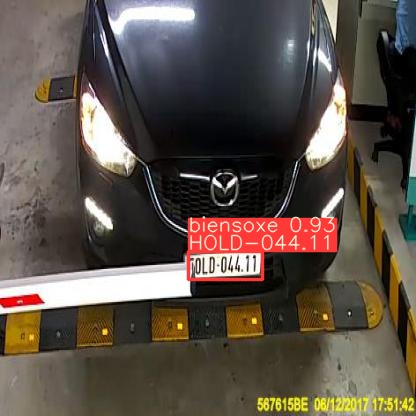

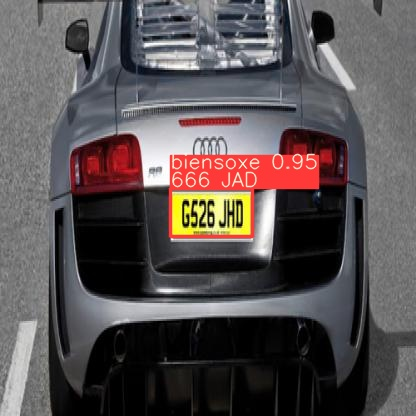

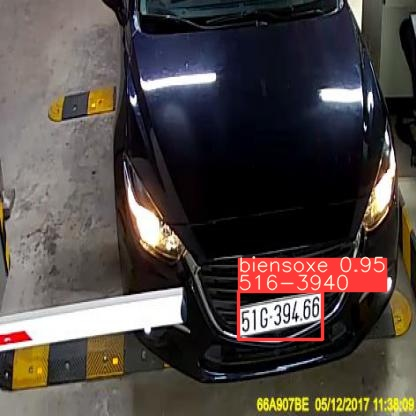

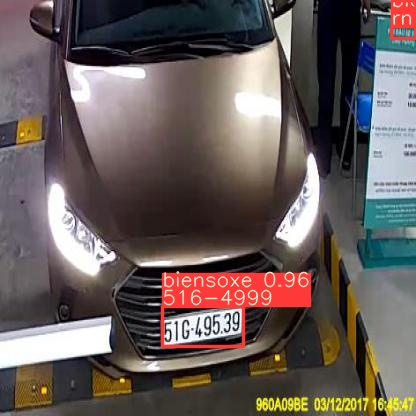

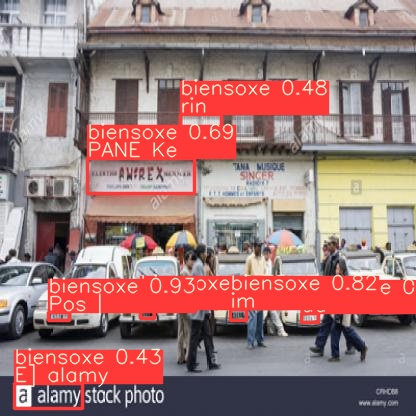

...

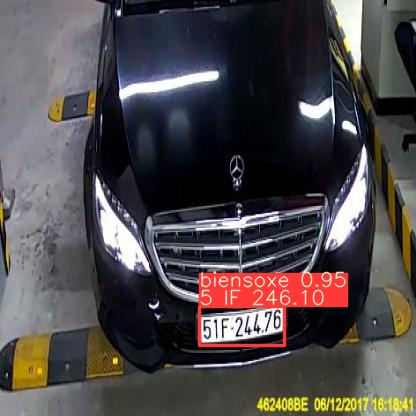

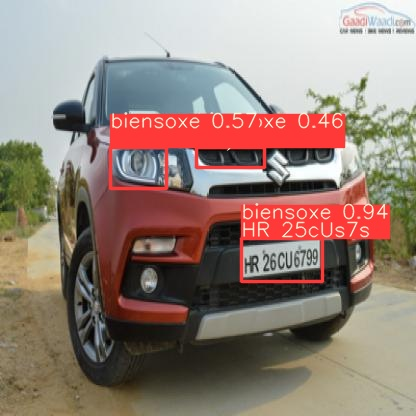

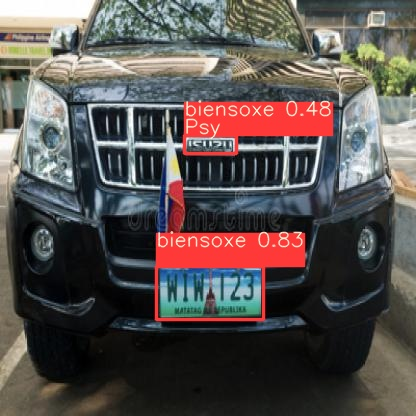

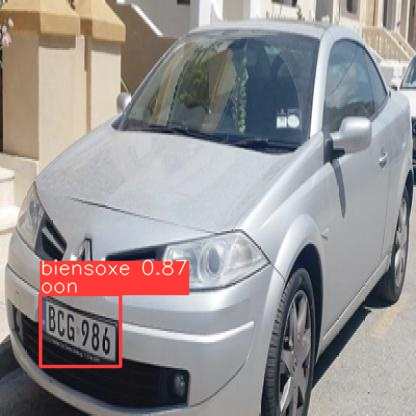

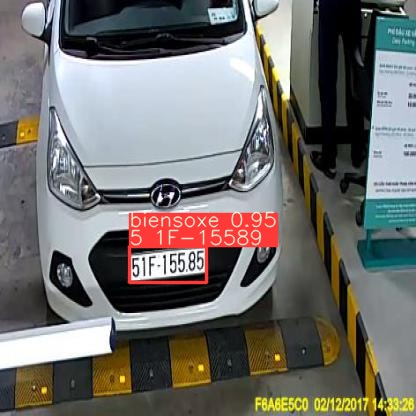

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', fourcc='mp4v', img_size=640, iou_thres=0.5, output='inference/output', save_txt=False, source='sample_cars/', view_img=False, weights='weights/last.pt')
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

/usr/local/lib/python3.7/dist-packages/torch/serialization.py:671: SourceChangeWarning: source code of class 'torch.nn.modules.container.Sequential' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/usr/local/lib/python3.7/dist-packages/torch/serialization.py:671: SourceChangeWarning: source code of class 'torch.nn.modules.conv.Conv2d' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch

['car_0.jpg', 'car_4.jpg', 'car_1.jpg', 'car_3.jpg', 'car_2.jpg']


## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)



```
# This is formatted as code
```

# Different way: Easy OCR



In [ ]:
!pip3 install easyocr
!pip3 install imutils
!pip3 install cv

In [ ]:
%ls

 CONTRIBUTING.md
'C:\Users\anill\Desktop\projects\number_plate\data\cropd.jpg'
 data/
 detect_custom.py
 detect.py
 Dockerfile
 export.py
 hubconf.py
 Licence-Plate-3-1/
 LICENSE
 models/
 README.md
 requirements.txt*
 runs/
 setup.cfg
 train.py
 tutorial.ipynb
 utils/
 val.py


In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import imutils
import easyocr

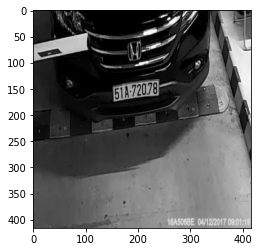

In [ ]:
img = cv2.imread('Licence-Plate-3-1/test/images/15886_jpg.rf.c9897481247e388abd58c5e66ec17591.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(cv2.cvtColor(gray, cv2.COLOR_BGR2RGB))

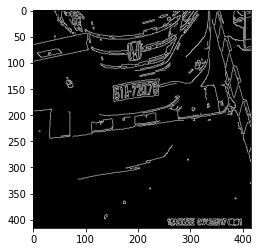

In [ ]:
bfilter = cv2.bilateralFilter(gray, 11, 17, 17) #Noise reduction
edged = cv2.Canny(bfilter, 30, 200) #Edge detection
plt.imshow(cv2.cvtColor(edged, cv2.COLOR_BGR2RGB))

In [ ]:
keypoints = cv2.findContours(edged.copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contours = imutils.grab_contours(keypoints)
contours = sorted(contours, key=cv2.contourArea, reverse=True)[:10]

In [ ]:
location = None
for contour in contours:
    approx = cv2.approxPolyDP(contour, 10, True)
    if len(approx) == 4:
        location = approx
        break

In [ ]:
location

array([[[241, 132]],

       [[153, 144]],

       [[154, 174]],

       [[237, 163]]], dtype=int32)

In [ ]:
mask = np.zeros(gray.shape, np.uint8)
new_image = cv2.drawContours(mask, [location], 0,255, -1)
new_image = cv2.bitwise_and(img, img, mask=mask)

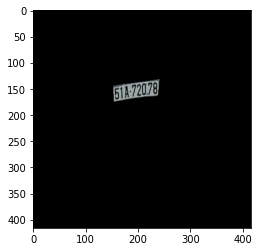

In [ ]:
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))

In [ ]:
(x,y) = np.where(mask==255)
(x1, y1) = (np.min(x), np.min(y))
(x2, y2) = (np.max(x), np.max(y))
cropped_image = gray[x1:x2+1, y1:y2+1]

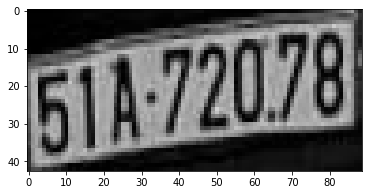

In [ ]:
plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))

In [ ]:
reader = easyocr.Reader(['en'])
result = reader.readtext(cropped_image)
result

[([[-6.119995760012721, 10.608006783979649],
   [93.56173872878432, -1.8204442391564313],
   [97.11999576001271, 33.39199321602035],
   [-3.5617387287843227, 47.82044423915643]],
  '6172078',
  0.7966384001241804)]

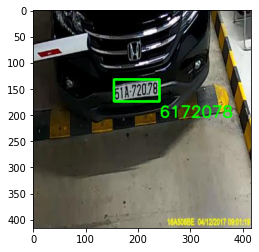

In [ ]:
text = result[0][-2]
font = cv2.FONT_HERSHEY_SIMPLEX
res = cv2.putText(img, text=text, org=(approx[0][0][0], approx[1][0][1]+60), fontFace=font, fontScale=1, color=(0,255,0), thickness=2, lineType=cv2.LINE_AA)
res = cv2.rectangle(img, tuple(approx[0][0]), tuple(approx[2][0]), (0,255,0),3)
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)

In [ ]:
from pytesseract import image_to_string
import pytesseract
import cv2

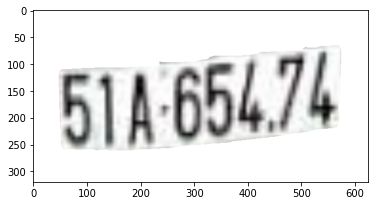

In [ ]:
# imports
import cv2
import numpy as np

img = cv2.imread('/content/yolov5/runs/detect/exp/crops/biensoxe/10690_jpg.rf.7773105a39a0ea0d2cef7a04ea93cc35.jpg')  # read image
# you can resize the image here if you like - it should still work for both sizes
h, w = img.shape[:2]  # get the actual images height and width
img = cv2.resize(img, (int(w*320/h), 320))
h, w = img.shape[:2]

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # transform to grayscale
thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]  # perform OTSU threhold
cv2.rectangle(thresh, (0, 0), (w, h), (0, 0, 0), 2)
contours = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)[0]  # search for contours
max_cnt = max(contours, key=cv2.contourArea)  # select biggest one
mask = np.zeros((h, w), dtype=np.uint8)  # create a black mask
cv2.drawContours(mask, [max_cnt], -1, (255, 255, 255), -1)  # draw biggest contour on the mask
kernel = np.ones((15, 15), dtype=np.uint8)  # make a kernel with appropriate values - in both cases (resized and original) 15 is ok
erosion = cv2.erode(mask, kernel, iterations=1)  # erode the mask with given kernel

reverse = cv2.bitwise_not(img.copy())  # reversed image of the actual image 0 becomes 255 and 255 becomes 0
img = cv2.bitwise_and(reverse, reverse, mask=erosion)  # per-element bit-wise conjunction of the actual image and eroded mask (erosion)
img = cv2.bitwise_not(img)  # revers the image again

# save image to file and display
# cv2.imwrite("res.png", img)
plt.imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()
# text1 = pytesseract.image_to_string(img, config='-l eng --oem 1 --psm 7 -c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890')
# print(text1)

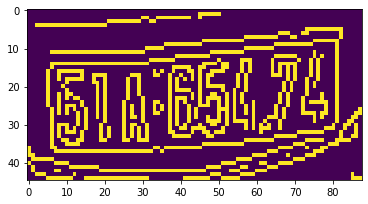

In [ ]:
image = cv2.imread('/content/yolov5/runs/detect/exp/crops/biensoxe/10690_jpg.rf.7773105a39a0ea0d2cef7a04ea93cc35.jpg')

gray = get_grayscale(image)
thresh = thresholding(gray)
opening = opening(gray)
canny = canny(gray)
plt.imshow(gray)
plt.imshow(thresh)
plt.imshow(opening)
plt.imshow(canny)

# text1 = pytesseract.image_to_string(canny, config='-l eng --oem 1 --psm 7 -c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890')
# print(text1)

In [ ]:

# Loading the required python modules
import pytesseract # this is tesseract module
import matplotlib.pyplot as plt
import cv2 # this is opencv module
import glob
import os


# Read the license plate file and display it
test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/10690_jpg.rf.7773105a39a0ea0d2cef7a04ea93cc35.jpg")
crop1 = test_license_plate
# cv2.imwrite('C:\\Users\\anill\\Desktop\\projects\\number_plate\\data\\cropd.jpg',crop1)




grayscale_resize_test_license_plate = cv2.cvtColor(
crop1, cv2.COLOR_BGR2GRAY)

gaussian_blur_license_plate = cv2.GaussianBlur(
grayscale_resize_test_license_plate, (5, 5), 0)


contours, hierarchy = cv2.findContours(grayscale_resize_test_license_plate,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)

#contour with the largest area is possibly the plate
max_area = 0
max_cnt = None
for cnt in contours:
    area = cv2.contourArea(cnt)
    if(area > max_area):
        max_area = area 
        max_cnt = cnt

min_rect = cv2.minAreaRect(max_cnt)
# print(min_rect)
((x,y),(w,h),angle) = min_rect
#rotate
M = cv2.getRotationMatrix2D((w/2, h/2), angle, 1.0)
w = int(w)
h = int(h)


rotated_plate = cv2.warpAffine(grayscale_resize_test_license_plate, M, (w,h))



text1 = pytesseract.image_to_string(rotated_plate, config='-l eng --oem 1 --psm 7 -c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890')
print(text1)

plt.imshow(rotated_plate)



-




51A-656,74



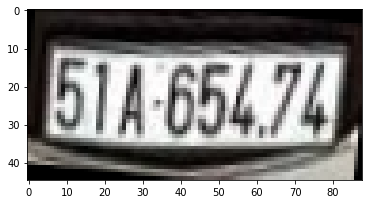

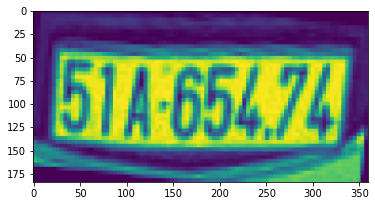

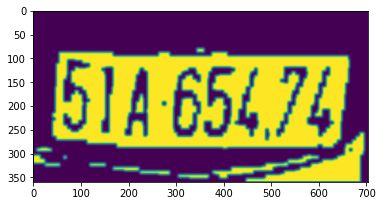

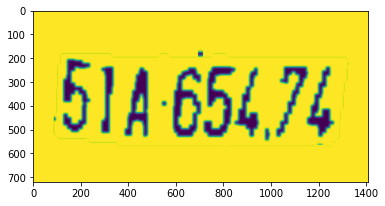

In [42]:
import pytesseract # this is tesseract module
import matplotlib.pyplot as plt
import cv2 # this is opencv module
import glob
import os
import math
import numpy as np
import imutils

# get grayscale image
def get_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# noise removal
def remove_noise(image):
    return cv2.medianBlur(image,5)
 
#thresholding
def thresholding(image):
    return cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

#dilation
def dilate(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.dilate(image, kernel, iterations = 1)
    
#erosion
def erode(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.erode(image, kernel, iterations = 1)

def rotate_image(image, angle):
    image_center = tuple(np.array(image.shape[1::-1]) / 2)
    rot_mat = cv2.getRotationMatrix2D(image_center, angle, 1.0)
    result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR)
    return result

def compute_skew(src_img):

    if len(src_img.shape) == 3:
        h, w, _ = src_img.shape
    elif len(src_img.shape) == 2:
        h, w = src_img.shape
    else:
        print('upsupported image type')

    img = cv2.medianBlur(src_img, 3)

    edges = cv2.Canny(img,  threshold1 = 30,  threshold2 = 100, apertureSize = 3, L2gradient = True)
    lines = cv2.HoughLinesP(edges, 1, math.pi/180, 30, minLineLength=w / 4.0, maxLineGap=h/4.0)
    angle = 0.0
    nlines = lines.size

    #print(nlines)
    cnt = 0
    for x1, y1, x2, y2 in lines[0]:
        ang = np.arctan2(y2 - y1, x2 - x1)
        #print(ang)
        if math.fabs(ang) <= 30: # excluding extreme rotations
            angle += ang
            cnt += 1

    if cnt == 0:
        return 0.0
    return (angle / cnt)*180/math.pi

def deskew(src_img):
    return rotate_image(src_img, compute_skew(src_img))

#template matching
def match_template(image, template):
    return cv2.matchTemplate(image, template, cv2.TM_CCOEFF_NORMED)

test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/10690_jpg.rf.7773105a39a0ea0d2cef7a04ea93cc35.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/282_jpg.rf.3185ca6bd25fe682c1a981e16b9ff7ae.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/34755_jpg.rf.a132a6114baa6185bbb89118702dd6f9.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/9043_jpg.rf.74090ce009eb9c36346b0cb922b50632.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/6814_jpg.rf.875a8b91d5c295555fcbb7c4ac91fa91.jpg")




img = test_license_plate
img = deskew(img)

plot1 = plt.figure(0)
plt.imshow(img)

img = imutils.resize(img, width=360 )

gray = get_grayscale(img)
# gray = cv2.bilateralFilter(gray, 11, 17, 17)


plot1 = plt.figure(1)
plt.imshow(gray)

thresh = thresholding(gray)
thresh = cv2.GaussianBlur(
    thresh, (5, 5), 0)

img = thresh
h, w = img.shape[:2]  # get the actual images height and width
img = cv2.resize(img, (int(w*360/h), 360))
h, w = img.shape[:2]

# # gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # transform to grayscale
# thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]  # perform OTSU threhold
cv2.rectangle(img, (0, 0), (w, h), (0, 0, 0), 2)
contours = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)[0]  # search for contours
max_cnt = max(contours, key=cv2.contourArea)  # select biggest one
mask = np.zeros((h, w), dtype=np.uint8)  # create a black mask
cv2.drawContours(mask, [max_cnt], -1, (255, 255, 255), -1)  # draw biggest contour on the mask
plot1 = plt.figure(2)
plt.imshow(img)
kernel = np.ones((15, 15), dtype=np.uint8)  # make a kernel with appropriate values - in both cases (resized and original) 15 is ok
erosion = cv2.erode(mask, kernel, iterations=1)  # erode the mask with given kernel

reverse = cv2.bitwise_not(img.copy())  # reversed image of the actual image 0 becomes 255 and 255 becomes 0
img = cv2.bitwise_and(reverse, reverse, mask=erosion)  # per-element bit-wise conjunction of the actual image and eroded mask (erosion)
img = cv2.bitwise_not(img)  # revers the image again

img = cv2.resize(
    img, None, fx = 2, fy = 2, 
    interpolation = cv2.INTER_CUBIC)

plot1 = plt.figure(4)
plt.imshow(img)

thresh = img





text2 = pytesseract.image_to_string(gray, lang='eng',config='-c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890 --oem 1 --psm 7 ')
print(text2)
text3 = pytesseract.image_to_string(thresh, lang='eng', config='-c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890 --oem 1 --psm 7 ')
print(text3)





ML-046.11 |

(pLD-O44. 11

(OLD OMA



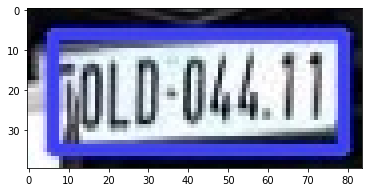

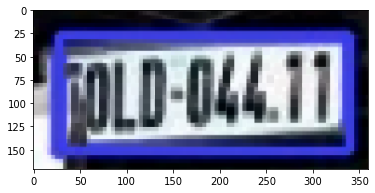

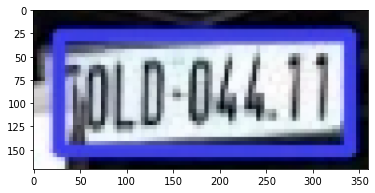

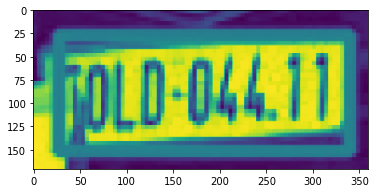

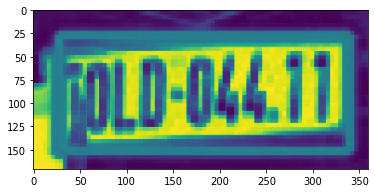

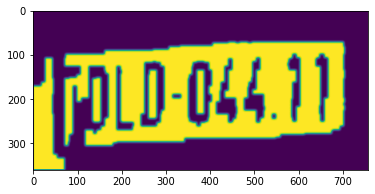

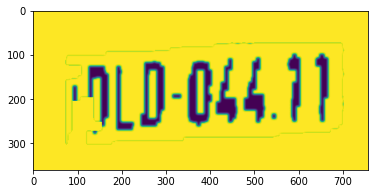

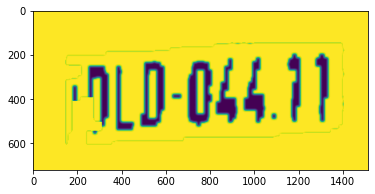

In [8]:
import pytesseract # this is tesseract module
import matplotlib.pyplot as plt
import cv2 # this is opencv module
import glob
import os
import math
import numpy as np
import imutils
from keras.preprocessing import image

# get grayscale image
def get_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# noise removal
def remove_noise(image):
    return cv2.medianBlur(image,5)
 
#thresholding
def thresholding(image):
    return cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

#dilation
def dilate(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.dilate(image, kernel, iterations = 1)
    
#erosion
def erode(image):
    kernel = np.ones((5,5),np.uint8)
    return cv2.erode(image, kernel, iterations = 1)

def rotate_image(image, angle):
    image_center = tuple(np.array(image.shape[1::-1]) / 2)
    rot_mat = cv2.getRotationMatrix2D(image_center, angle, 1.0)
    result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR)
    return result

def compute_skew(src_img):

    if len(src_img.shape) == 3:
        h, w, _ = src_img.shape
    elif len(src_img.shape) == 2:
        h, w = src_img.shape
    else:
        print('upsupported image type')

    img = cv2.medianBlur(src_img, 3)

    edges = cv2.Canny(img,  threshold1 = 30,  threshold2 = 100, apertureSize = 3, L2gradient = True)
    lines = cv2.HoughLinesP(edges, 1, math.pi/180, 30, minLineLength=w / 4.0, maxLineGap=h/4.0)
    angle = 0.0
    if isinstance(lines,np.ndarray):
      nlines = lines.size
    else:
      return 1
      
    #print(nlines)
    cnt = 0
    for x1, y1, x2, y2 in lines[0]:
        ang = np.arctan2(y2 - y1, x2 - x1)
        #print(ang)
        if math.fabs(ang) <= 30: # excluding extreme rotations
            angle += ang
            cnt += 1

    if cnt == 0:
        return 0.0
    return (angle / cnt)*180/math.pi

def deskew(src_img):
    return rotate_image(src_img, compute_skew(src_img))

#template matching
def match_template(image, template):
    return cv2.matchTemplate(image, template, cv2.TM_CCOEFF_NORMED)

# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/10690_jpg.rf.7773105a39a0ea0d2cef7a04ea93cc35.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/282_jpg.rf.3185ca6bd25fe682c1a981e16b9ff7ae.jpg")
test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/34755_jpg.rf.a132a6114baa6185bbb89118702dd6f9.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/9043_jpg.rf.74090ce009eb9c36346b0cb922b50632.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/7145_jpg.rf.2581b877b95750d9e33e5cdd31ba6e31.jpg")
# test_license_plate = cv2.imread("/content/yolov5/runs/detect/exp/crops/biensoxe/7145_jpg.rf.2581b877b95750d9e33e5cdd31ba6e312.jpg")




img = test_license_plate
img = deskew(img)

plot1 = plt.figure(0)
plt.imshow(img)

img = imutils.resize(img, width=360 )
img2 = image.img_to_array(img, dtype='uint8')
erod = erode(img)
plot1 = plt.figure(1)
plt.imshow(erod)

dial = dilate(erod)
plot1 = plt.figure(2)
plt.imshow(dial)

gray = get_grayscale(dial)
# gray = cv2.bilateralFilter(gray, 11, 17, 17)
gray2 = get_grayscale(erod)

plot1 = plt.figure(3)
plt.imshow(gray)

plot1 = plt.figure(4)
plt.imshow(gray2)

thresh = thresholding(gray)
thresh = cv2.GaussianBlur(
    thresh, (5, 5), 0)

img = thresh
h, w = img.shape[:2]  # get the actual images height and width
img = cv2.resize(img, (int(w*360/h), 360))
h, w = img.shape[:2]

# # gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # transform to grayscale
# thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]  # perform OTSU threhold
cv2.rectangle(img, (0, 0), (w, h), (0, 0, 0), 2)
contours = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)[0]  # search for contours
max_cnt = max(contours, key=cv2.contourArea)  # select biggest one
mask = np.zeros((h, w), dtype=np.uint8)  # create a black mask
cv2.drawContours(mask, [max_cnt], -1, (255, 255, 255), -1)  # draw biggest contour on the mask
plot1 = plt.figure(5)
plt.imshow(img)
kernel = np.ones((15, 15), dtype=np.uint8)  # make a kernel with appropriate values - in both cases (resized and original) 15 is ok
erosion = cv2.erode(mask, kernel, iterations=1)  # erode the mask with given kernel

reverse = cv2.bitwise_not(img.copy())  # reversed image of the actual image 0 becomes 255 and 255 becomes 0
img = cv2.bitwise_and(reverse, reverse, mask=erosion)  # per-element bit-wise conjunction of the actual image and eroded mask (erosion)
img = cv2.bitwise_not(img)  # revers the image again

# img = erode(img)

plot1 = plt.figure(6)
plt.imshow(img)

img = cv2.resize(
    img, None, fx = 2, fy = 2, 
    interpolation = cv2.INTER_CUBIC)

plot1 = plt.figure(7)
plt.imshow(img)

thresh = img



text1 = pytesseract.image_to_string(img2, lang='eng',config='-c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890 --oem 1 --psm 7 ')
print(text1)

text2 = pytesseract.image_to_string(gray, lang='eng',config='-c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890 --oem 1 --psm 7 ')
print(text2)
text3 = pytesseract.image_to_string(gray2, lang='eng', config='-c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ1234567890 --oem 1 --psm 7 ')
print(text3)



